In [9]:
import matplotlib.pyplot as plt
import numpy as np
import os
import random 

from src.spa import read_absorbance

In [10]:
path_to_files  = r"resources/samples"
files = os.listdir(path_to_files)

spectra = np.array([read_absorbance(os.path.join(path_to_files, file)) for file in files])
types = np.array([0, 2, 1, 2])

In [11]:
for i in range(5):
    spectra = np.append(spectra, spectra, axis=0)
    types = np.append(types, types, axis=0)

In [12]:
import numpy as np
import random

class RandomNoise:
    def __init__(self, noise_factor=1e-3):
        self.noise_factor = noise_factor

    def __call__(self, data):
        noise = np.random.randn(*data.shape) * self.noise_factor
        return data + noise

class RandomShift:
    def __init__(self, shift=10):
        self.shift = shift

    def __call__(self, data):
        shift = random.randint(-self.shift, self.shift)
        return np.roll(data, shift)

class RandomScaling:
    def __init__(self, scale=0.2):
        self.scale = scale

    def __call__(self, data):
        scaling = random.uniform(1-self.scale, 1+self.scale)
        return data * scaling

class BaselineShift:
    def __init__(self, shift=0.1):
        self.shift = shift

    def __call__(self, data):
        baseline = np.random.uniform(0, self.shift)
        return data + baseline

class IntensityDependentNoise:
    def __init__(self, noise_factor=0.01):
        self.noise_factor = noise_factor

    def __call__(self, data):
        noise = np.random.randn(*data.shape) * self.noise_factor
        return data + noise * data

class FeatureDependentBaselineShift:
    def __init__(self, shift=1e-4):
        self.shift = shift

    def __call__(self, data):
        baseline = np.random.uniform(0, self.shift)
        indices = np.linspace(0, len(data), len(data))
        return data + baseline * indices


In [46]:
augmentation_steps = [RandomShift(), RandomScaling(), RandomNoise(), BaselineShift(), FeatureDependentBaselineShift(), IntensityDependentNoise()]

In [45]:
class DataAugmentation():
    def __init__(self, augmentation_steps: list):
        self.augmentation_steps = augmentation_steps

    def random(self, x: np.ndarray):
        augmentation_steps = random.sample(self.augmentation_steps, len(self.augmentation_steps))
        for step in augmentation_steps:
            x = step(x)
        return x
    
    def ordered(self, x: np.ndarray):
        for step in self.augmentation_steps:
            x = step(x)
        return x

In [48]:
augmentation = DataAugmentation(augmentation_steps)
augmented_spectra = [augmentation.random(spectrum) for spectrum in spectra]

In [49]:
# make plot in plotly and color by type
import plotly.graph_objects as go
import pandas as pd

spectra_df = pd.DataFrame(spectra)

colors = ["cyan", "navy", "magenta"]
fig = go.Figure()
for i, spectrum in enumerate(augmented_spectra):
    fig.add_trace(go.Scatter(x=np.linspace(0, 1000, len(spectrum)), y=spectrum, line=dict(color=colors[types[i]],), mode='lines'))

fig.show()

In [35]:
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

from chemotools.baseline import LinearCorrection
from chemotools.derivative import SavitzkyGolay
from chemotools.scatter import MultiplicativeScatterCorrection, StandardNormalVariate
from chemotools.smooth import WhittakerSmooth
from chemotools.variable_selection import RangeCut

In [37]:
pipeline = make_pipeline(
    StandardNormalVariate(),
    SavitzkyGolay(window_size=21, polynomial_order=2),
    StandardScaler(with_std=False))

pca = PCA(n_components=2)
processed_data = pipeline.fit_transform(spectra)
scores = pca.fit_transform(processed_data)



In [41]:
colors = ["cyan", "navy", "magenta"]
fig = go.Figure()
for i, spectrum in enumerate(processed_data):
    fig.add_trace(go.Scatter(x=np.linspace(0, 1000, len(spectrum)), y=spectrum, line=dict(color=colors[types[i]],), mode='lines'))

fig.show()

In [42]:
# make plot in plotly and color by type
colors = ["cyan", "navy", "magenta"]
types_colors = [colors[i] for i in types]
fig = go.Figure()
fig.add_trace(go.Scatter(x=scores[:,0], y=scores[:,1], marker=dict(color=types_colors,), mode='markers'))
fig.update_layout(
    title="Score plot",
    xaxis_title="PC1",
    yaxis_title="PC2",
    width=600,
    height=600,
    autosize=False,
    xaxis=dict(scaleanchor="y", scaleratio=2),
    yaxis=dict(scaleanchor="x", scaleratio=2),
    showlegend=True,
)
fig.show()

Accuracy:  0.9230769230769231
Confusion matrix: 
 [[ 9  0  0]
 [ 2  4  0]
 [ 0  0 11]]


Text(0, 0.5, 'True')

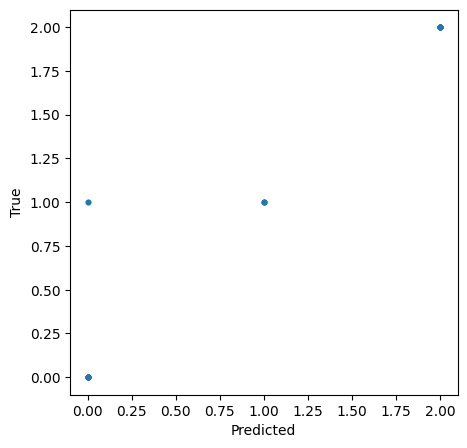

In [ ]:
# pls-da
from sklearn.cross_decomposition import PLSRegression
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(processed_data, types, test_size=0.2, random_state=42)

pls = PLSRegression(n_components=1, scale=False)
pls.fit(X_train, y_train)

y_pred = pls.predict(X_test)

def classify(y):
    if y < 0.5:
        return 1
    elif y < 1.5:
        return 0
    else:
        return 2

y_pred_label = np.array([classify(y) for y in y_pred])

print("Accuracy: ", accuracy_score(y_test, y_pred_label))
print("Confusion matrix: \n", confusion_matrix(y_test, y_pred_label))

# plot scores and color by type
plt.figure(figsize=(5, 5))
plt.scatter(y_pred_label, y_test, s=10);
plt.xlabel("Predicted")
plt.ylabel("True")



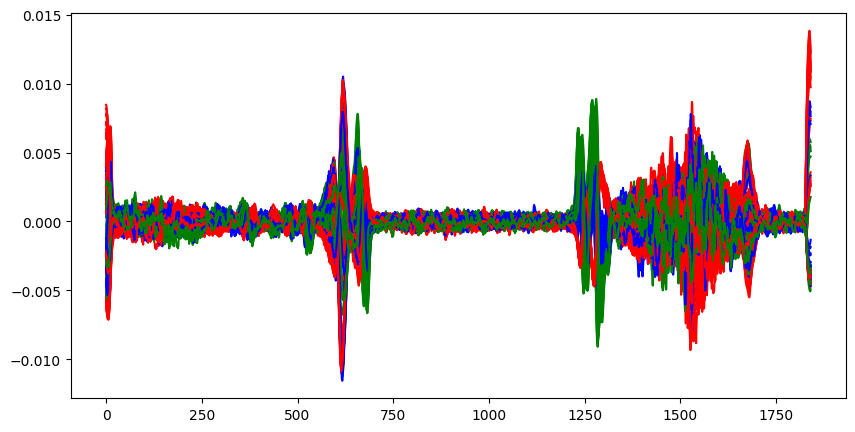

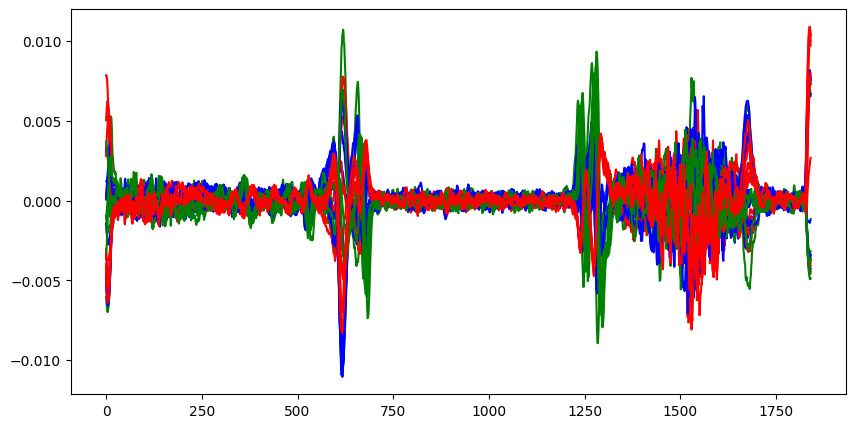

In [ ]:
# plot training set and color by type
plt.figure(figsize=(10, 5))
for i, spectrum in enumerate(X_train):
    if y_train[i] == 0:
        plt.plot(spectrum, color="blue")
    elif y_train[i] == 1:
        plt.plot(spectrum, color="green")
    else:
        plt.plot(spectrum, color="red")


# plot test set and color by type
plt.figure(figsize=(10, 5))
for i, spectrum in enumerate(X_test):
    if y_test[i] == 0:
        plt.plot(spectrum, color="blue")
    elif y_test[i] == 1:
        plt.plot(spectrum, color="green")
    else:
        plt.plot(spectrum, color="red")